In [234]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import balanced_accuracy_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import seaborn as sns

In [257]:
df = pd.read_csv('team_match_data_full.csv')
df = df.fillna(0)
df = df.drop('Unnamed: 0', axis=1)

In [258]:
df

,match_id,team_id,team_name,team_rating,date,won_corners,att_sv_low_centre,won_contest,total_tackle,aerial_lost,possession_percentage,accurate_pass,total_pass,total_throws,shot_off_target,total_offside,blocked_scoring_att,ontarget_scoring_att,aerial_won,att_miss_left,total_scoring_att,fk_foul_lost,att_miss_right,att_goal_low_left,att_goal_low_right,att_sv_low_left,goals,att_pen_goal,att_sv_high_centre,att_goal_low_centre,att_miss_high,att_post_left,post_scoring_att,att_miss_high_right,att_sv_high_right,att_sv_low_right,att_sv_high_left,att_miss_high_left,att_goal_high_right,att_goal_high_left,att_post_right,att_goal_high_centre,penalty_save,att_post_high
0,1190418,166,Huddersfield,6.140000,30/01/2018,1.0,1.0,5.0,11,15,25.3,214,308,15,2.0,3.0,2.0,1.0,16,1.0,5.0,8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1190418,26,Liverpool,7.222857,30/01/2018,4.0,2.0,6.0,13,16,74.7,809,913,24,3.0,2.0,4.0,7.0,15,0.0,14.0,8,3.0,1.0,1.0,1.0,3.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1190424,211,Brighton,7.153846,01/01/2018,5.0,1.0,12.0,23,16,49.1,300,394,21,3.0,1.0,6.0,6.0,25,0.0,15.0,13,2.0,0.0,1.0,3.0,2.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1190424,183,Bournemouth,6.902857,01/01/2018,12.0,3.0,17.0,6,25,50.9,329,403,19,5.0,0.0,13.0,8.0,16,0.0,26.0,9,2.0,1.0,1.0,0.0,2.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1190342,15,Chelsea,6.771429,13/01/2018,6.0,1.0,15.0,13,18,55.4,426,508,21,4.0,5.0,6.0,7.0,11,2.0,17.0,14,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1190342,14,Leicester,6.955000,13/01/2018,3.0,1.0,21.0,15,11,44.6,329,415,17,6.0,3.0,7.0,1.0,18,3.0,14.0,13,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,1190356,26,Liverpool,7.844286,26/12/2017,4.0,2.0,24.0,20,12,55.0,530,601,14,7.0,3.0,6.0,9.0,8,4.0,22.0,5,1.0,0.0,0.0,1.0,5.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
7,1190356,259,Swansea,5.831429,26/12/2017,2.0,1.0,9.0,13,8,45.0,422,496,17,2.0,0.0,1.0,4.0,12,0.0,7.0,8,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,1190430,15,Chelsea,6.489286,31/01/2018,8.0,3.0,22.0,16,10,65.7,517,618,29,8.0,4.0,8.0,5.0,23,0.0,21.0,5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1190430,183,Bournemouth,7.367143,31/01/2018,5.0,1.0,10.0,23,23,34.3,241,329,20,2.0,2.0,4.0,5.0,10,1.0,11.0,12,0.0,0.0,1.0,0.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [259]:
df.insert(2, 'result', 0)

In [262]:
column_n = df.pop('result')
df.insert(1, 'result', column_n, allow_duplicates = False)

In [261]:
column_n = df.pop('goals')
df.insert(2, 'goals', column_n, allow_duplicates = False)
df

,match_id,team_id,goals,result,team_name,team_rating,date,won_corners,att_sv_low_centre,won_contest,total_tackle,aerial_lost,possession_percentage,accurate_pass,total_pass,total_throws,shot_off_target,total_offside,blocked_scoring_att,ontarget_scoring_att,aerial_won,att_miss_left,total_scoring_att,fk_foul_lost,att_miss_right,att_goal_low_left,att_goal_low_right,att_sv_low_left,att_pen_goal,att_sv_high_centre,att_goal_low_centre,att_miss_high,att_post_left,post_scoring_att,att_miss_high_right,att_sv_high_right,att_sv_low_right,att_sv_high_left,att_miss_high_left,att_goal_high_right,att_goal_high_left,att_post_right,att_goal_high_centre,penalty_save,att_post_high
0,1190418,166,0.0,0,Huddersfield,6.140000,30/01/2018,1.0,1.0,5.0,11,15,25.3,214,308,15,2.0,3.0,2.0,1.0,16,1.0,5.0,8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1190418,26,3.0,0,Liverpool,7.222857,30/01/2018,4.0,2.0,6.0,13,16,74.7,809,913,24,3.0,2.0,4.0,7.0,15,0.0,14.0,8,3.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1190424,211,2.0,0,Brighton,7.153846,01/01/2018,5.0,1.0,12.0,23,16,49.1,300,394,21,3.0,1.0,6.0,6.0,25,0.0,15.0,13,2.0,0.0,1.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1190424,183,2.0,0,Bournemouth,6.902857,01/01/2018,12.0,3.0,17.0,6,25,50.9,329,403,19,5.0,0.0,13.0,8.0,16,0.0,26.0,9,2.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1190342,15,0.0,0,Chelsea,6.771429,13/01/2018,6.0,1.0,15.0,13,18,55.4,426,508,21,4.0,5.0,6.0,7.0,11,2.0,17.0,14,0.0,0.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1190342,14,0.0,0,Leicester,6.955000,13/01/2018,3.0,1.0,21.0,15,11,44.6,329,415,17,6.0,3.0,7.0,1.0,18,3.0,14.0,13,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,1190356,26,5.0,0,Liverpool,7.844286,26/12/2017,4.0,2.0,24.0,20,12,55.0,530,601,14,7.0,3.0,6.0,9.0,8,4.0,22.0,5,1.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
7,1190356,259,0.0,0,Swansea,5.831429,26/12/2017,2.0,1.0,9.0,13,8,45.0,422,496,17,2.0,0.0,1.0,4.0,12,0.0,7.0,8,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,1190430,15,0.0,0,Chelsea,6.489286,31/01/2018,8.0,3.0,22.0,16,10,65.7,517,618,29,8.0,4.0,8.0,5.0,23,0.0,21.0,5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1190430,183,3.0,0,Bournemouth,7.367143,31/01/2018,5.0,1.0,10.0,23,23,34.3,241,329,20,2.0,2.0,4.0,5.0,10,1.0,11.0,12,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [263]:
for i in range(0,3040,2):
    if df.goals.values[i] < df.goals.values[i+1]:
        df.result.values[i] = 0
        df.result.values[i+1] = 3
    elif df.goals.values[i] > df.goals.values[i+1]:
        df.result.values[i] = 3
        df.result.values[i+1] = 0
    else:
        df.result.values[i] = 1
        df.result.values[i+1] = 1

In [197]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
df

,match_id,result,goals,team_id,team_name,team_rating,date,won_corners,att_sv_low_centre,won_contest,total_tackle,aerial_lost,possession_percentage,accurate_pass,total_pass,total_throws,shot_off_target,total_offside,blocked_scoring_att,ontarget_scoring_att,aerial_won,att_miss_left,total_scoring_att,fk_foul_lost,att_miss_right,att_goal_low_left,att_goal_low_right,att_sv_low_left,att_pen_goal,att_sv_high_centre,att_goal_low_centre,att_miss_high,att_post_left,post_scoring_att,att_miss_high_right,att_sv_high_right,att_sv_low_right,att_sv_high_left,att_miss_high_left,att_goal_high_right,att_goal_high_left,att_post_right,att_goal_high_centre,penalty_save,att_post_high
0,1190418,0,0.0,166,Huddersfield,6.140000,30/01/2018,1.0,1.0,5,11,15,25.3,214,308,15,2.0,3.0,2.0,1.0,16,1.0,5.0,8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1190418,3,3.0,26,Liverpool,7.222857,30/01/2018,4.0,2.0,6,13,16,74.7,809,913,24,3.0,2.0,4.0,7.0,15,0.0,14.0,8,3.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1190424,1,2.0,211,Brighton,7.153846,01/01/2018,5.0,1.0,12,23,16,49.1,300,394,21,3.0,1.0,6.0,6.0,25,0.0,15.0,13,2.0,0.0,1.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1190424,1,2.0,183,Bournemouth,6.902857,01/01/2018,12.0,3.0,17,6,25,50.9,329,403,19,5.0,0.0,13.0,8.0,16,0.0,26.0,9,2.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1190342,1,0.0,15,Chelsea,6.771429,13/01/2018,6.0,1.0,15,13,18,55.4,426,508,21,4.0,5.0,6.0,7.0,11,2.0,17.0,14,0.0,0.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1190342,1,0.0,14,Leicester,6.955000,13/01/2018,3.0,1.0,21,15,11,44.6,329,415,17,6.0,3.0,7.0,1.0,18,3.0,14.0,13,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,1190356,3,5.0,26,Liverpool,7.844286,26/12/2017,4.0,2.0,24,20,12,55.0,530,601,14,7.0,3.0,6.0,9.0,8,4.0,22.0,5,1.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
7,1190356,0,0.0,259,Swansea,5.831429,26/12/2017,2.0,1.0,9,13,8,45.0,422,496,17,2.0,0.0,1.0,4.0,12,0.0,7.0,8,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,1190430,0,0.0,15,Chelsea,6.489286,31/01/2018,8.0,3.0,22,16,10,65.7,517,618,29,8.0,4.0,8.0,5.0,23,0.0,21.0,5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1190430,3,3.0,183,Bournemouth,7.367143,31/01/2018,5.0,1.0,10,23,23,34.3,241,329,20,2.0,2.0,4.0,5.0,10,1.0,11.0,12,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [198]:
#df.to_csv('team_match_data1718_2.csv')

In [199]:
y = df.result
x = df.accurate_pass.values.reshape(-1,1)

In [200]:
print(x.shape,y.shape)

(760, 1) (760,)


In [201]:
model = LinearRegression().fit(x,y)

In [202]:
r_sq = model.score(x,y)
intercept = model.intercept_
slope = model.coef_

In [203]:
print(r_sq)

0.07524494248881863


In [204]:
y_pred = intercept + slope*x

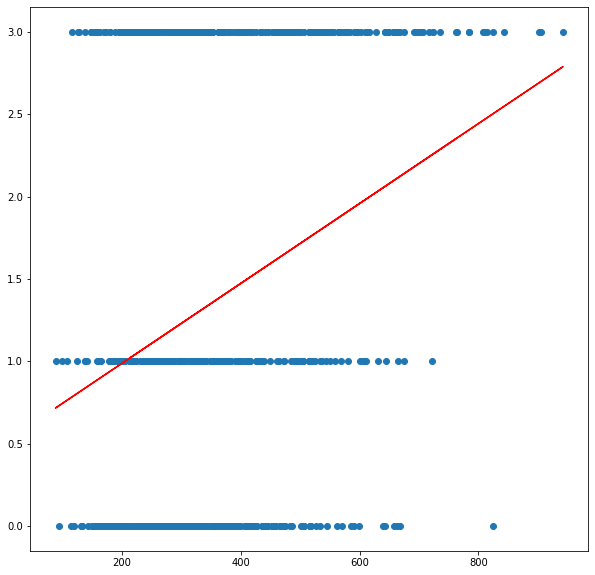

In [205]:
fig, ax = plt.subplots(figsize=(10,10))

plt.scatter(x,y)

plt.plot(x,y_pred, c = 'red')

In [206]:
df

,match_id,result,goals,team_id,team_name,team_rating,date,won_corners,att_sv_low_centre,won_contest,total_tackle,aerial_lost,possession_percentage,accurate_pass,total_pass,total_throws,shot_off_target,total_offside,blocked_scoring_att,ontarget_scoring_att,aerial_won,att_miss_left,total_scoring_att,fk_foul_lost,att_miss_right,att_goal_low_left,att_goal_low_right,att_sv_low_left,att_pen_goal,att_sv_high_centre,att_goal_low_centre,att_miss_high,att_post_left,post_scoring_att,att_miss_high_right,att_sv_high_right,att_sv_low_right,att_sv_high_left,att_miss_high_left,att_goal_high_right,att_goal_high_left,att_post_right,att_goal_high_centre,penalty_save,att_post_high
0,1190418,0,0.0,166,Huddersfield,6.140000,30/01/2018,1.0,1.0,5,11,15,25.3,214,308,15,2.0,3.0,2.0,1.0,16,1.0,5.0,8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1190418,3,3.0,26,Liverpool,7.222857,30/01/2018,4.0,2.0,6,13,16,74.7,809,913,24,3.0,2.0,4.0,7.0,15,0.0,14.0,8,3.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1190424,1,2.0,211,Brighton,7.153846,01/01/2018,5.0,1.0,12,23,16,49.1,300,394,21,3.0,1.0,6.0,6.0,25,0.0,15.0,13,2.0,0.0,1.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1190424,1,2.0,183,Bournemouth,6.902857,01/01/2018,12.0,3.0,17,6,25,50.9,329,403,19,5.0,0.0,13.0,8.0,16,0.0,26.0,9,2.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1190342,1,0.0,15,Chelsea,6.771429,13/01/2018,6.0,1.0,15,13,18,55.4,426,508,21,4.0,5.0,6.0,7.0,11,2.0,17.0,14,0.0,0.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1190342,1,0.0,14,Leicester,6.955000,13/01/2018,3.0,1.0,21,15,11,44.6,329,415,17,6.0,3.0,7.0,1.0,18,3.0,14.0,13,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,1190356,3,5.0,26,Liverpool,7.844286,26/12/2017,4.0,2.0,24,20,12,55.0,530,601,14,7.0,3.0,6.0,9.0,8,4.0,22.0,5,1.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
7,1190356,0,0.0,259,Swansea,5.831429,26/12/2017,2.0,1.0,9,13,8,45.0,422,496,17,2.0,0.0,1.0,4.0,12,0.0,7.0,8,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,1190430,0,0.0,15,Chelsea,6.489286,31/01/2018,8.0,3.0,22,16,10,65.7,517,618,29,8.0,4.0,8.0,5.0,23,0.0,21.0,5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
9,1190430,3,3.0,183,Bournemouth,7.367143,31/01/2018,5.0,1.0,10,23,23,34.3,241,329,20,2.0,2.0,4.0,5.0,10,1.0,11.0,12,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [247]:
# X should equal all of columns that are not 'W/L'
X = df.drop(['result','match_id','team_id','team_name'], axis=1)

# Y should equal the 'W/L' column
y = df['result']
X

,goals,team_rating,date,won_corners,att_sv_low_centre,won_contest,total_tackle,aerial_lost,possession_percentage,accurate_pass,total_pass,total_throws,shot_off_target,total_offside,blocked_scoring_att,ontarget_scoring_att,aerial_won,att_miss_left,total_scoring_att,fk_foul_lost,att_miss_right,att_goal_low_left,att_goal_low_right,att_sv_low_left,att_pen_goal,att_sv_high_centre,att_goal_low_centre,att_miss_high,att_post_left,post_scoring_att,att_miss_high_right,att_sv_high_right,att_sv_low_right,att_sv_high_left,att_miss_high_left,att_goal_high_right,att_goal_high_left,att_post_right,att_goal_high_centre,penalty_save,att_post_high
0,0.0,6.140000,30/01/2018,1.0,1.0,5,11,15,25.3,214,308,15,2.0,3.0,2.0,1.0,16,1.0,5.0,8,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,3.0,7.222857,30/01/2018,4.0,2.0,6,13,16,74.7,809,913,24,3.0,2.0,4.0,7.0,15,0.0,14.0,8,3.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2.0,7.153846,01/01/2018,5.0,1.0,12,23,16,49.1,300,394,21,3.0,1.0,6.0,6.0,25,0.0,15.0,13,2.0,0.0,1.0,3.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,2.0,6.902857,01/01/2018,12.0,3.0,17,6,25,50.9,329,403,19,5.0,0.0,13.0,8.0,16,0.0,26.0,9,2.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,6.771429,13/01/2018,6.0,1.0,15,13,18,55.4,426,508,21,4.0,5.0,6.0,7.0,11,2.0,17.0,14,0.0,0.0,0.0,2.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,6.955000,13/01/2018,3.0,1.0,21,15,11,44.6,329,415,17,6.0,3.0,7.0,1.0,18,3.0,14.0,13,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
6,5.0,7.844286,26/12/2017,4.0,2.0,24,20,12,55.0,530,601,14,7.0,3.0,6.0,9.0,8,4.0,22.0,5,1.0,0.0,0.0,1.0,0.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0
7,0.0,5.831429,26/12/2017,2.0,1.0,9,13,8,45.0,422,496,17,2.0,0.0,1.0,4.0,12,0.0,7.0,8,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,6.489286,31/01/2018,8.0,3.0,22,16,10,65.7,517,618,29,8.0,4.0,8.0,5.0,23,0.0,21.0,5,4.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
9,3.0,7.367143,31/01/2018,5.0,1.0,10,23,23,34.3,241,329,20,2.0,2.0,4.0,5.0,10,1.0,11.0,12,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [245]:
wins = y[y==3].index
ties = y[y==1].index
losses = y[y==0].index

<AxesSubplot:xlabel='accurate_pass', ylabel='Count'>

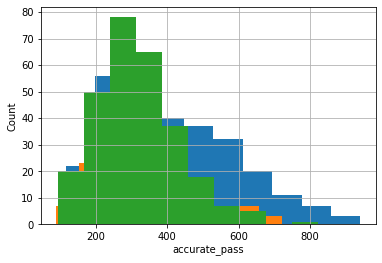

In [246]:
plt.xlabel("accurate_pass") # Fill this in with the name of column you are plotting on the x-axis
plt.ylabel("Count") # The y-axis of a histogram should always be count, unless you are making a density plot

### Plot two histograms of your target column: one filtered by wins and one filtered by losses ###
X['accurate_pass'][wins].hist() 
X['accurate_pass'][ties].hist() 
X['accurate_pass'][losses].hist()  # Plot histogram of 'PTS' column with data filtered by losses

In [248]:
X.columns

Index(['goals', 'team_rating', 'date', 'won_corners', 'att_sv_low_centre',
       'won_contest', 'total_tackle', 'aerial_lost', 'possession_percentage',
       'accurate_pass', 'total_pass', 'total_throws', 'shot_off_target',
       'total_offside', 'blocked_scoring_att', 'ontarget_scoring_att',
       'aerial_won', 'att_miss_left', 'total_scoring_att', 'fk_foul_lost',
       'att_miss_right', 'att_goal_low_left', 'att_goal_low_right',
       'att_sv_low_left', 'att_pen_goal', 'att_sv_high_centre',
       'att_goal_low_centre', 'att_miss_high', 'att_post_left',
       'post_scoring_att', 'att_miss_high_right', 'att_sv_high_right',
       'att_sv_low_right', 'att_sv_high_left', 'att_miss_high_left',
       'att_goal_high_right', 'att_goal_high_left', 'att_post_right',
       'att_goal_high_centre', 'penalty_save', 'att_post_high'],
      dtype='object')

In [211]:
X['accurate_pass'][wins].describe()

count    198.000000
mean     334.818182
std      125.000618
min       88.000000
25%      244.000000
50%      327.000000
75%      395.750000
max      722.000000
Name: accurate_pass, dtype: float64

In [249]:
quant_cols = []
for col in X.columns:
    if X[col].dtype == 'int' or X[col].dtype == 'float':
        quant_cols.append(col)

In [250]:
X_feat = X[quant_cols]
#standard scaler from sklearn (to make standard deviation)
sts = StandardScaler()
X_feat_std = sts.fit_transform(X_feat)

In [214]:
#logistic regression
model = LogisticRegression()  # Initiate a classification model, for example KNN, Logistic Regression, SVC, etc.
             # refer to sklearn documntation for this...
for col in X_feat:
    model.fit(X_feat[[col]], y)  # Fit your newly initiated model to the column at X_feat and y
    pred = model.predict(X_feat[[col]])  # Generate predictions based on the column at X_feat
    print("{}:".format(col))
    print("Total Accuracy:",sum(pred == y) / len(y))
    print()

match_id:
Total Accuracy: 0.36973684210526314

goals:
Total Accuracy: 0.6210526315789474

team_id:
Total Accuracy: 0.4131578947368421

team_rating:
Total Accuracy: 0.7986842105263158

won_corners:
Total Accuracy: 0.40657894736842104

att_sv_low_centre:
Total Accuracy: 0.4276315789473684

won_contest:
Total Accuracy: 0.40789473684210525

total_tackle:
Total Accuracy: 0.3736842105263158

aerial_lost:
Total Accuracy: 0.39473684210526316

possession_percentage:
Total Accuracy: 0.44473684210526315

accurate_pass:
Total Accuracy: 0.45789473684210524

total_pass:
Total Accuracy: 0.4513157894736842

total_throws:
Total Accuracy: 0.38026315789473686

shot_off_target:
Total Accuracy: 0.4131578947368421

total_offside:
Total Accuracy: 0.3815789473684211

blocked_scoring_att:
Total Accuracy: 0.425

ontarget_scoring_att:
Total Accuracy: 0.55

aerial_won:
Total Accuracy: 0.39473684210526316

att_miss_left:
Total Accuracy: 0.38421052631578945

total_scoring_att:
Total Accuracy: 0.5013157894736842

fk

In [254]:
X_train, X_test, y_train, y_test = train_test_split(X_feat_std, y, test_size=0.33)

In [239]:
#K nearest neighbors
classifier = KNeighborsClassifier(5) # Initialize a classifier here
## Fit and predict using X_train, y_train, and X_test
classifier.fit(X_train, y_train) # Fit classifier to your X_train and y_train
pred = classifier.predict(X_test)  # Generate predictions based on X_test

In [255]:
#SVC model analysis
model = SVC()

model.fit(X_train, y_train)
pred = model.predict(X_test)


In [256]:
#accuracy calc
sum(pred == y_test) / len(pred)

0.7211155378486056

<AxesSubplot:>

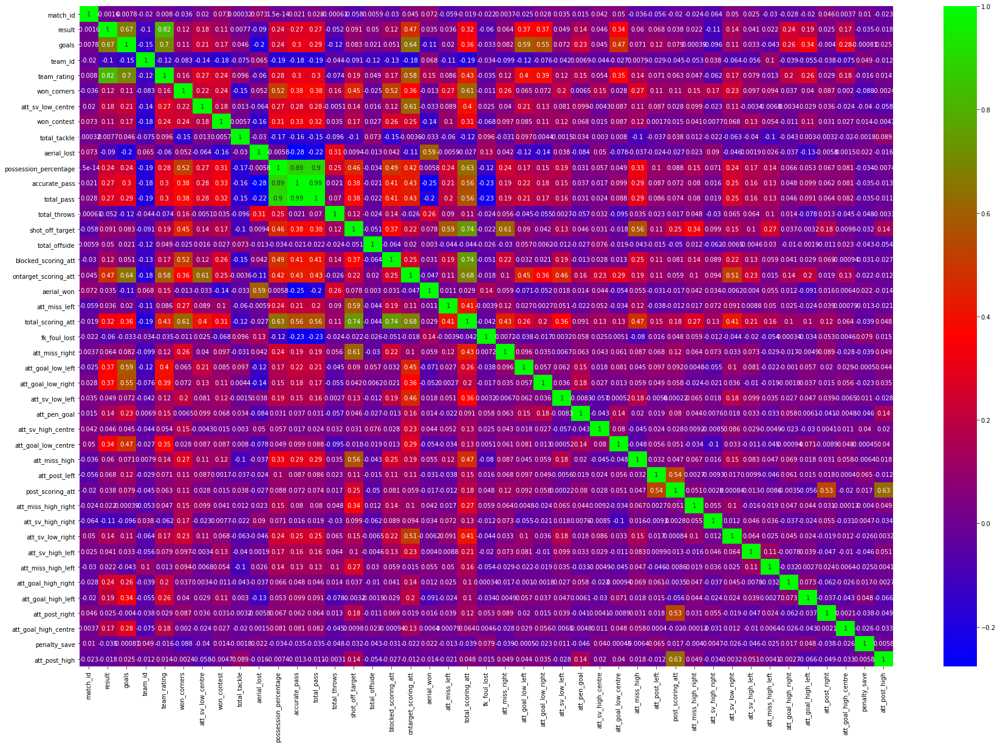

In [242]:
plt.figure(figsize=(30,20)) 
sns.heatmap(df.corr(), annot = True, cmap = 'brg')